# Cleaning data for the segmentation model
This file is used:
<ul>
<li> Select 100 scenes to be labelled 
<li> Create RGB images using entire landsat scenes. These are then labelled and the final product is considered a rough label. 
<li> Clean labels from the above process
<li> Crop 100 test images
<li> Crop 30000 training images that are geographical independent of the test images 
</ul>

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image 
import rasterio as rio
import tifffile as tiff

import os
import cv2

# Reload utils
import importlib
import utils
importlib.reload(utils)

base_path = '../data/'

# Create RGB visualization of each landsat scene
<br>
These are imported to label studio to create rough labels

In [29]:
df_label = pd.read_csv('../data/label_scenes.csv')

print(df_label[['path','row']].value_counts(sort=False))
df_label[['path','row']].value_counts(sort=False).to_clipboard()

print(df_label['altitude_category'].value_counts())

path  row
205   23     11
      24     20
206   22      9
      23      6
      24     10
207   22      9
      23     10
      24      7
208   22      6
      23      6
      24      6
dtype: int64
low       34
medium    34
high      32
Name: altitude_category, dtype: int64


In [56]:
# create RGB images 
for i, row in df_label.iterrows():
    try:
        id = row['id']
        RGB = utils.get_rgb(id)
        RGB = utils.trim_RGB(RGB)
        RGB_ = (RGB*255).astype(np.uint8)
        im = Image.fromarray(RGB_)
        im.save(base_path+"RGB/{}.png".format(id))
    except:
        print(id)

TRIM
TRIM
TRIM
TRIM
TRIM


In [39]:
# display examples of each path and row 
df = df_label.groupby(['path', 'row']).last().reset_index()
print(len(df))
df.head()

rgb_examples = []
for i, row in df.iterrows():
    rgb = utils.get_rgb(row['id'],infrared=True)

    # resize to 1/10 size
    rgb = cv2.resize(rgb, (0,0), fx=0.1, fy=0.1)
    rgb_examples.append(rgb)

11


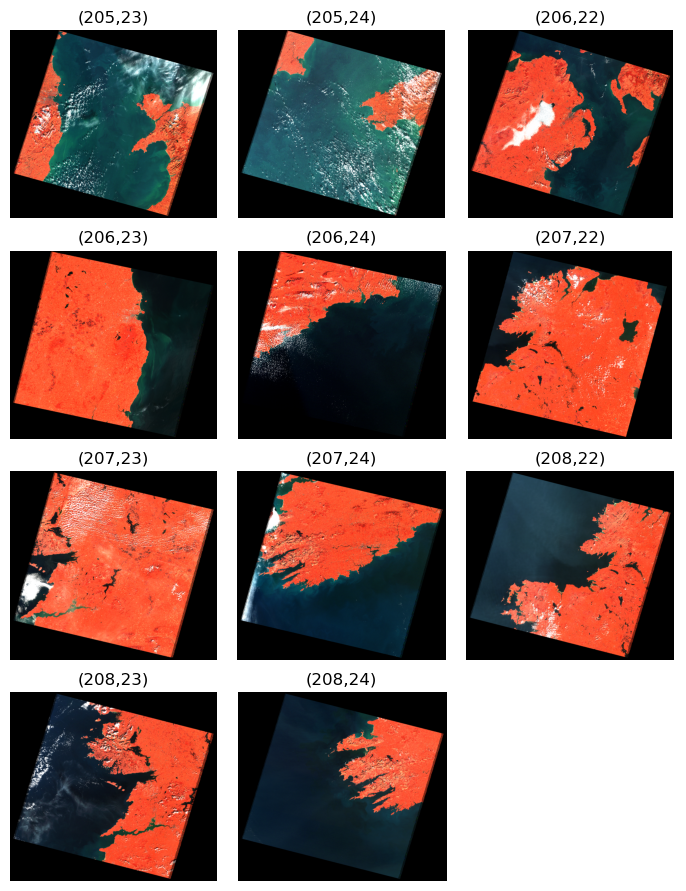

In [51]:
fig, ax = plt.subplots(4, 3, figsize=(7, 9))

for i, row in df.iterrows():
    rgb = rgb_examples[i]
    ax[i//3, i%3].imshow(rgb)
    ax[i//3, i%3].set_title("({},{})".format(row['path'], row['row']))
    ax[i//3, i%3].axis('off')

ax[3, 2].axis('off')
plt.tight_layout()

utils.save_fig(fig,"Landsat_tiles")

# Clean masks

In [9]:
df_label = pd.read_csv('../data/label_scenes.csv')

# Get list of RGB visualizations that were trimmed
trimmed = []
for id in df_label['id']:
    try:
        rgb = utils.get_rgb(id)

        x,y,z = rgb.shape

        if x*y > 67000000:
            trimmed.append(id)
    except:
        print(id)

In [20]:
mask_names = os.listdir(base_path + 'rough masks/')

#Only keep .npy files
mask_names = [name for name in mask_names if name[-4:]=='.npy']

#sort labels
mask_names = sorted(mask_names)

print(len(mask_names))

104


In [22]:
# create initial label masks
masks = []
prev_task = None
for mask_name in mask_names:

    # get task number
    task = mask_name.split('-')[1]

    # load label
    mask = np.load(base_path + 'rough masks/' + mask_name)
    mask = np.clip(mask,0,1)

    if task != prev_task:
        masks.append(mask)
    else:
        # add to previous mask if same task
        masks[-1] = masks[-1] + mask
        masks[-1] = np.clip(masks[-1],0,1)


    prev_task = task
print(len(masks))

100


In [23]:
# untrim labels
for i, mask in enumerate(masks):

    id = df_label.iloc[i]['id']

    if id in trimmed:
        masks[i] = utils.untrim_label(mask)
        print(i,id)


11 LC08_L2SP_206022_20140418_20200911_02_T1
12 LC08_L2SP_206022_20140723_20200911_02_T1
13 LC08_L2SP_206022_20170325_20200904_02_T1
14 LC08_L2SP_206022_20180702_20200831_02_T1
15 LC08_L2SP_206022_20230310_20230320_02_T1


In [24]:
#clean masks
for i, mask in enumerate(masks):

    # make mask = 1 for water and 0 otherwise
    masks[i] = 1 - np.array(mask)

    try: 
        id = df_label.iloc[i]['id']
        QA = utils.get_QA(id)

        # make mask = 0 where QA = 1
        flag = QA==1
        masks[i][flag] = 0
    except:
        print(id)

In [25]:
# save masks as .npy files
for i, mask in enumerate(masks):
    id = df_label.iloc[i]['id']
    np.save(base_path + 'clean masks/' + id + '.npy', mask)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/var/folders/_j/wkrsnnnn2lj6cds3dhhlkkh40000gn/T/ipykernel_14853/1235502688.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1,2,figsize=(10,20))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow wit

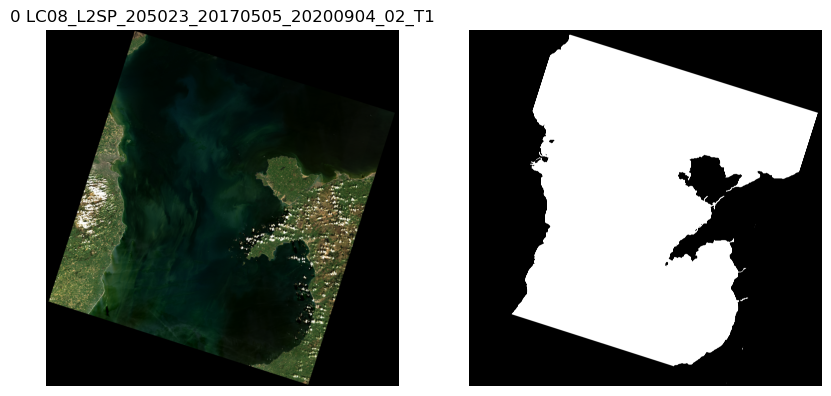

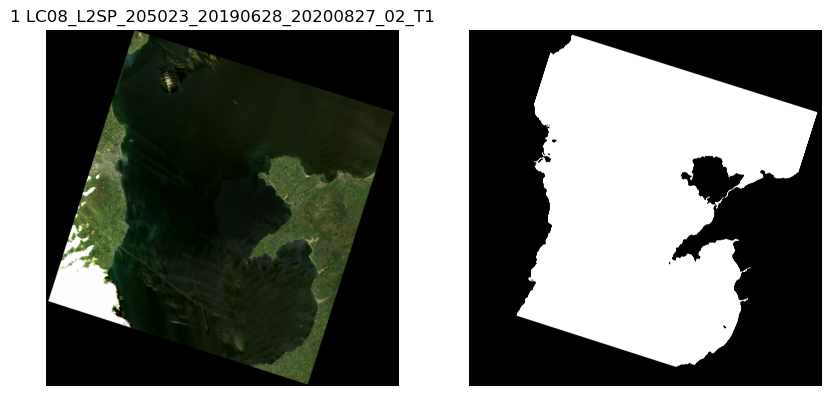

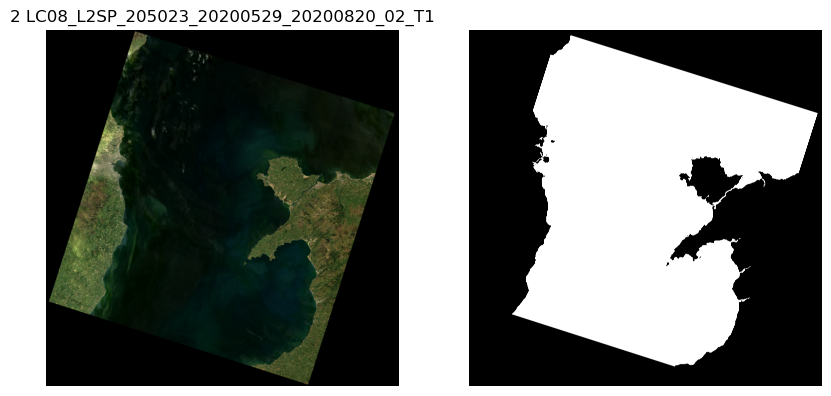

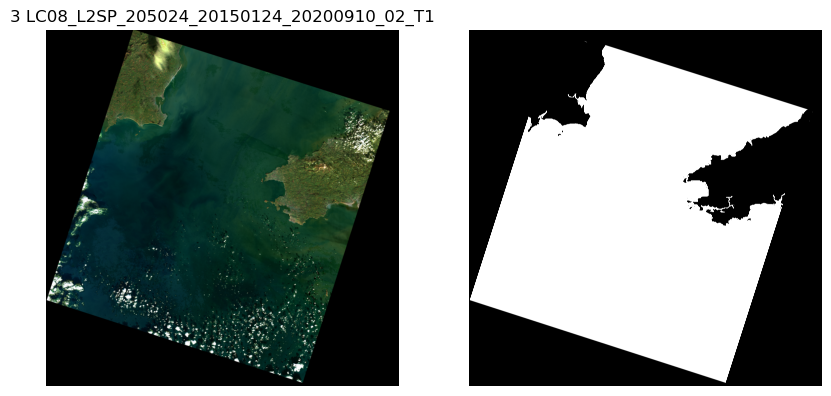

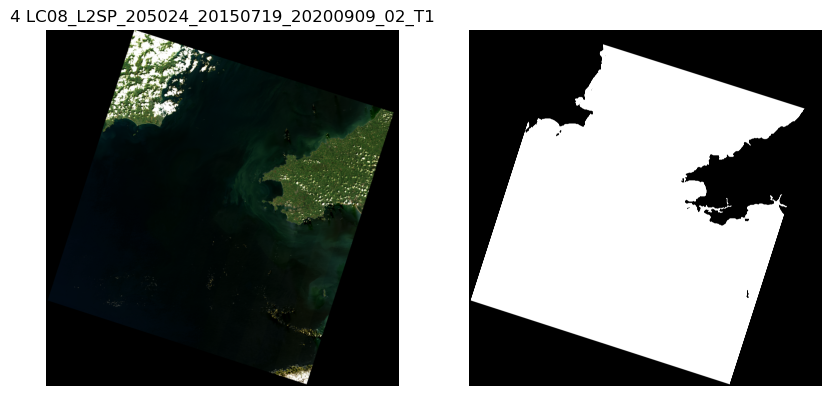

...

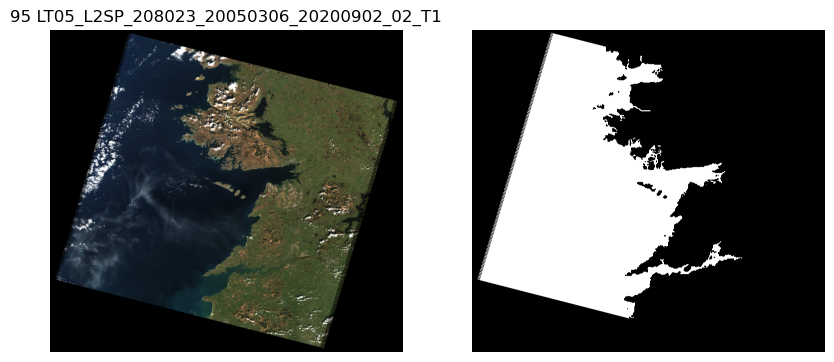

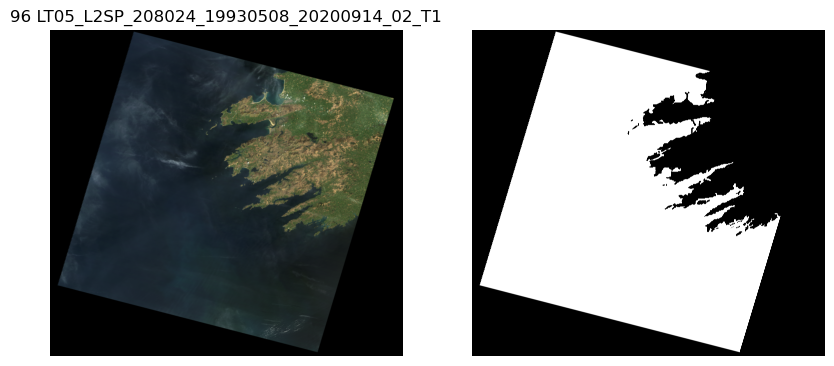

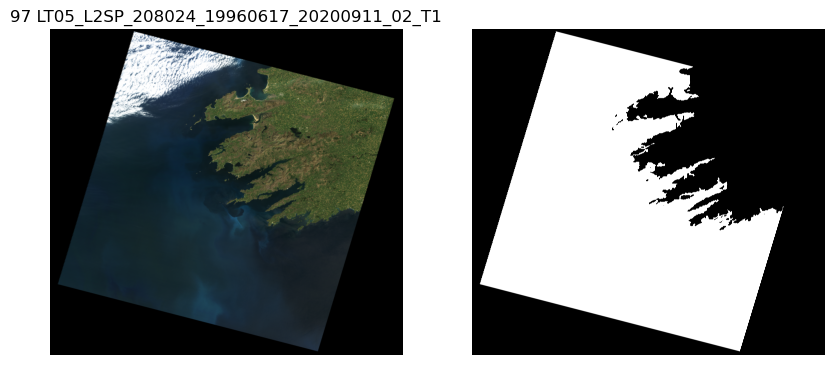

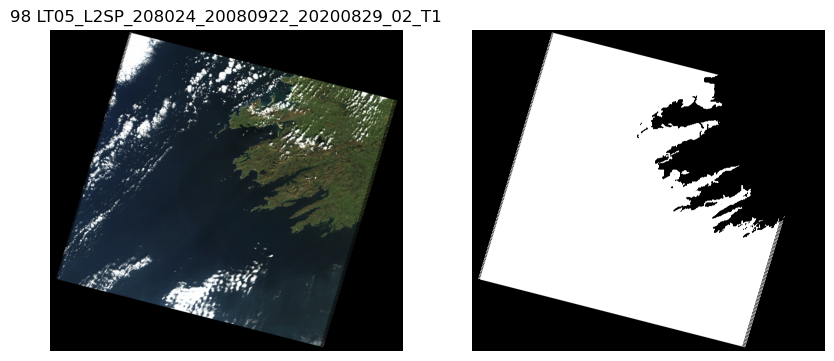

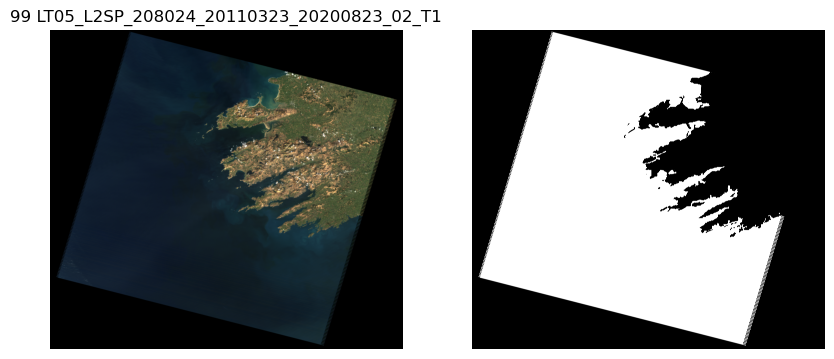

In [16]:
# display all rgb images and masks 
for i, mask in enumerate(masks):


    id = df_label.iloc[i]['id']
    RGB = utils.get_rgb(id)

    # check if mask is binary
    if set(mask.ravel()) != {0,1}:
        print(i,id,"NOT BINARY")

    # reduce RGB dimensions
    RGB = cv2.resize(RGB, (int(mask.shape[1]/10), int(mask.shape[0]/10)), interpolation = cv2.INTER_AREA)

    # display RGB and mask
    fig,ax = plt.subplots(1,2,figsize=(10,20))

    ax[0].imshow(RGB)
    ax[0].title.set_text("{} {}".format(i,id))

    ax[1].imshow(mask,cmap='gray')

    ax[0].axis('off')
    ax[1].axis('off')

# Create stack npy files


In [6]:
df_label = pd.read_csv('../data/label_scenes.csv')

def get_mask(val,type='cloud'):
    
    """Get mask for a specific cover type"""

    # convert to binary
    bin_ = '{0:016b}'.format(val)

    # reverse string
    str_bin = str(bin_)[::-1]

    # get bit for cover type
    bits = {'cloud':3,'shadow':4,'dilated_cloud':1,'cirrus':2}
    bit = str_bin[bits[type]]

    if bit == '1':
        return 0 # cover
    else:
        return 1 # no cover


QA = utils.get_QA(df_label['id'][0])
QA

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=uint16)

In [26]:
df_label = pd.read_csv('../data/label_scenes.csv')

for id in df_label['id']:

    if id[0:4] in ['LT05','LE07']:
        bands = ['SR_B1','SR_B2','SR_B3','SR_B4','SR_B5','SR_B7','ST_B6']
    else:
        bands = ['SR_B2','SR_B3','SR_B4','SR_B5','SR_B6','SR_B7','ST_B10']

    paths = [base_path+f'raw scenes/{id}/{id}_{band}.TIF' for band in bands]

    # create stack
    stack = np.stack([tiff.imread(path) for path in paths],axis=2)

    #append cloud mask
    QA = utils.get_QA(id)
    stack = np.concatenate([stack,QA[:,:,np.newaxis]],axis=2)

    # append mask
    mask = np.load(base_path + 'clean masks/' + id + '.npy')
    stack = np.concatenate([stack,mask[:,:,np.newaxis]],axis=2)

    # save stack
    np.save(base_path + 'stacked/' + id + '.npy', stack)


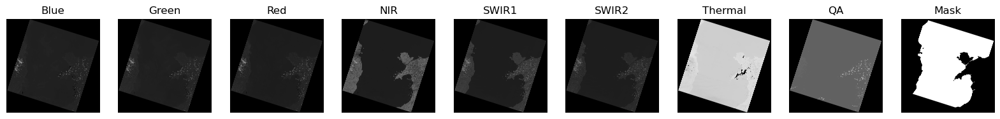

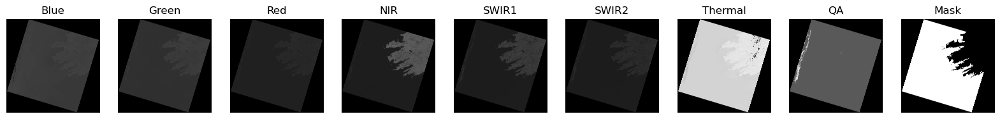

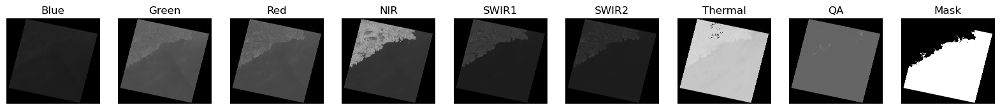

In [27]:
#Example of stacked image
stack = np.load(base_path + 'stacked/' + df_label['id'][0] + '.npy')
utils.display_bands(stack,True)

stack = np.load(base_path + 'stacked/' + df_label['id'][30] + '.npy')
utils.display_bands(stack,True)

stack = np.load(base_path + 'stacked/' + df_label['id'][70] + '.npy')
utils.display_bands(stack,True)

# Archive 

In [ ]:
# create stack tiff files 

df_label = pd.read_csv('../data/label_scenes.csv')

# save label as tif file
for id in df_label['id']:
    # load label
    mask = np.load(base_path + 'clean labels/' + id + '.npy')

    tiff_file = base_path + "raw scenes/{}/{}_mask.TIF".format(id,id)
    tiff.imsave(tiff_file, mask)

for ID in df_label['id']:

    if ID[0:4] in ['LT05','LE07']:
        bands = ['SR_B1','SR_B2','SR_B3','SR_B4','SR_B5','SR_B7','ST_B6','mask']
    else:
        bands = ['SR_B2','SR_B3','SR_B4','SR_B5','SR_B6','SR_B7','ST_B10','mask']


    paths = [base_path+'raw scenes/{}/{}_{}.TIF'.format(ID,ID,band) for band in bands]

    # load all bands and label with rasterio
    with rio.open(paths[0]) as src:
        meta = src.meta
        meta.update(count=len(paths))

    save_path = base_path + 'stacked/{}.TIF'.format(ID)
    with rio.open(save_path, 'w', **meta) as dst:
        for id, layer in enumerate(paths, start=1):
            with rio.open(layer) as src1:
                dst.write_band(id, src1.read(1))

In [111]:
import torch 
import torch.nn as nn
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader

# Variables
train_path = "../data/training/" #UPDATE

class TrainDataset(torch.utils.data.Dataset):
    def __init__(self, paths):
        self.paths = paths


    def __getitem__(self, idx):
        """Get image and binary mask for a given index"""

        path = self.paths[idx]
        instance = np.load(path)

        # Get spectral bands
        bands = instance[:,:,:-1]
        bands = bands[:,:,incl_bands] # Only include specified bands
        bands = bands.astype(np.float32)

        # Normalise bands
        bands = np.clip(bands*0.0000275-0.2, 0, 1)

        # Convert to tensor
        bands = bands.transpose(2,0,1)
        bands = torch.tensor(bands)

        # Get target
        mask_1 = instance[:,:,-1].astype(np.int8) # Water = 1, Land = 0
        mask_0 = 1-mask_1 

        target = np.array([mask_0,mask_1])
        target = torch.Tensor(target).squeeze()
    
        return bands, target

    def __len__(self):
        return len(self.paths)
    
    


In [112]:
import glob
paths = glob.glob(train_path + "*")
print("Training images: {}".format(len(paths)))

Training images: 30000


In [118]:
sample = True

if sample: 
    paths = paths[:1000]

# Create a datasets for training and validation
split = int(0.9 * len(paths))
train_data = TrainDataset(paths[:split])
valid_data = TrainDataset(paths[split:])



Bands shape: torch.Size([7, 256, 256])
Min: 0.0 Max: 1.0 Avg: 0.26378417015075684
Target shape: torch.Size([2, 256, 256])
Target unique: tensor([0., 1.])


In [64]:
import os

check_path = "/Users/conorosullivan/Documents/git/COASTAL MONITORING/landsat-coastline-segmentation/data/RGB"

# check if all scenes have been downloaded
for id in df_label['id']:
    path =  id + ".png"
    if path not in os.listdir(check_path):
        print(path)

In [66]:
for i,id in enumerate(df_label['id']):

    path =  "{}.png".format(id)
    im = Image.open("../data/RGB/"+path)
    
    im = np.array(im)
    x, y, z = im.shape
    pixels = x*y

    print(i+1,id, pixels)

1 LC08_L2SP_205023_20170505_20200904_02_T1 65949041
2 LC08_L2SP_205023_20190628_20200827_02_T1 66029851
3 LC08_L2SP_205023_20200529_20200820_02_T1 66111561
4 LC08_L2SP_205024_20150124_20200910_02_T1 66192471
5 LC08_L2SP_205024_20150719_20200909_02_T1 66192471
6 LC08_L2SP_205024_20160331_20200907_02_T1 66192471
7 LC08_L2SP_205024_20190204_20200829_02_T1 66111561
8 LC08_L2SP_205024_20190324_20200829_02_T1 66192471
9 LC08_L2SP_205024_20200411_20200822_02_T1 66192471
10 LC08_L2SP_205024_20210719_20210729_02_T1 66273381
11 LC08_L2SP_205024_20230420_20230429_02_T1 66192471
12 LC08_L2SP_206022_20140418_20200911_02_T1 65942541
13 LC08_L2SP_206022_20140723_20200911_02_T1 65942541
14 LC08_L2SP_206022_20170325_20200904_02_T1 65942541
15 LC08_L2SP_206022_20180702_20200831_02_T1 65942541
16 LC08_L2SP_206022_20230310_20230320_02_T1 65942541
17 LC08_L2SP_206024_20130720_20200912_02_T1 61792821
18 LC08_L2SP_206024_20150421_20200909_02_T1 61792821
19 LC08_L2SP_206024_20170120_20200905_02_T1 61792821
20

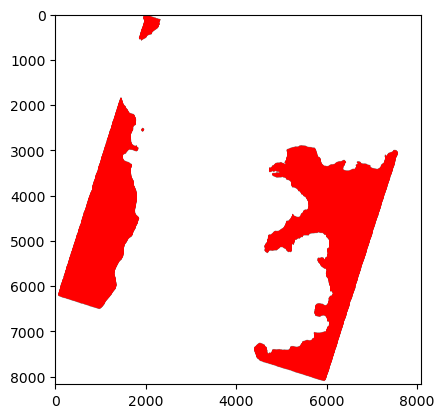

In [29]:
label = Image.open(base_path+"RGB/example - all labels.png")

label = np.array(label)

label.shape

plt.imshow(label)
